In [2]:
from astropy.table import Table
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

import matplotlib
%matplotlib inline

In [23]:
def show_jpegs(gals, cols=6, img_type='both', print_fraction=False):
    cols = 6
    
    num = int(round(len(gals)/cols)*cols)
    if num < len(gals): num+=cols
    
    rows = int(num/cols)
        
    labels = np.linspace(1,num,num)
    v_align, h_align = ['bottom', 'top'], ['left','left']
    xy_coords = [(0.02, 0.02),(0.02, 0.97)]


    f=plt.figure(figsize=(30,rows*6))
    gs=gridspec.GridSpec(rows,6, wspace=0., hspace=0.)

    n=0
    for i in range (0,rows):
        for j in range(0,cols):
            
            ax=plt.subplot(gs[i,j])
            plt.rc('text', usetex=True)
            
            if n < len(gals):
                gal = gals[n]            
            
                if img_type=='both':
                    if n % 2 == 0:
                        img = Image.open('beta_sample/{}.jpg'.format(gal['GZ_ASSET_ID']))
                    else:
                        img = Image.open('beta_sample/{}_resized.jpg'.format(gal['GZ_ASSET_ID']))

                elif img_type=='regular':
                    img = Image.open('beta_sample/{}.jpg'.format(gal['GZ_ASSET_ID']))

                elif img_type=='zoomed':
                    img = Image.open('beta_sample/{}_resized.jpg'.format(gal['GZ_ASSET_ID']))
                    
                plt.imshow(img)
                plt.tick_params(labelbottom='off',labelleft='off')
                ax.set_title(gal['SDSS_ID'], fontsize=25)
                
                ax.annotate("clump$_{avg} = %i$"%gal['clumps'],
                            fontsize=28,xy=xy_coords[0], color='white',
                            xycoords='axes fraction',
                            verticalalignment=v_align[0], 
                            horizontalalignment=h_align[0])
                
                if print_fraction:
                    ax.annotate("$f_{\mathrm{clump}} = %.2f$"%gal['clump_fraction'],
                                fontsize=28,xy=xy_coords[1], color='white',
                                xycoords='axes fraction',
                                verticalalignment=v_align[1], 
                                horizontalalignment=h_align[1]) 
                
            
            n+=1

    plt.savefig('clumpdump_1-16-17_clumpcompare.png')

In [4]:
clumpdump = Table.read('clumpdump_1-16-17_output.csv', format='ascii.commented_header')

In [5]:
clumpy = clumpdump[clumpdump['clump_fraction'] >= 0.8]

clumpy.sort('GZ_ASSET_ID')
index = []

for idx, id in enumerate(clumpy['GZ_ASSET_ID']):
    if np.sum(id==clumpy['GZ_ASSET_ID'])>1:
        index.append(idx)

print len(index)

38


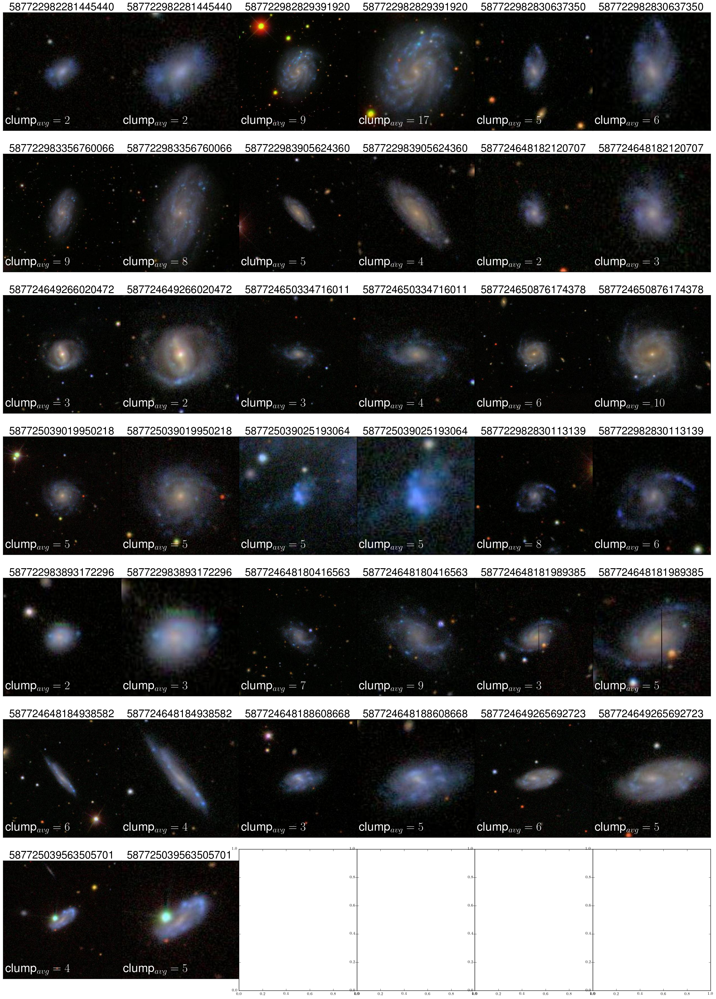

In [9]:
show_jpegs(clumpy[index], img_type='both')

In [29]:
zoom_only, reg_of_zoom, reg_only, zoom_of_reg = [], [], [], []

for idx, gal in enumerate(clumpy):
    if (gal['zoom']==1) & (np.sum(gal['GZ_ASSET_ID']==clumpy['GZ_ASSET_ID'])==1):
        zoom_only.append(idx)
        
        counterpart = np.where((gal['GZ_ASSET_ID']==clumpdump['GZ_ASSET_ID']) & 
                               (clumpdump['zoom']==0))[0][0]
        reg_of_zoom.append(counterpart)
        
    elif (gal['zoom']==0) & (np.sum(gal['GZ_ASSET_ID']==clumpy['GZ_ASSET_ID'])==1):
        reg_only.append(idx)
        
        counterpart = np.where((gal['GZ_ASSET_ID']==clumpdump['GZ_ASSET_ID']) & 
                               (clumpdump['zoom']==1))[0][0]
        zoom_of_reg.append(counterpart)

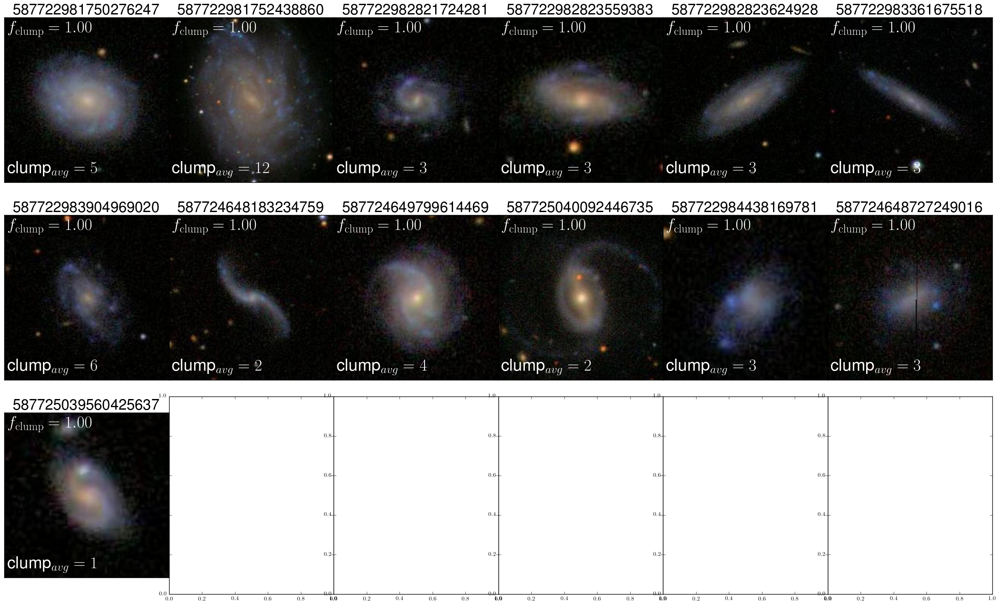

In [26]:
show_jpegs(clumpy[zoom_only], img_type='zoomed', print_fraction=True)

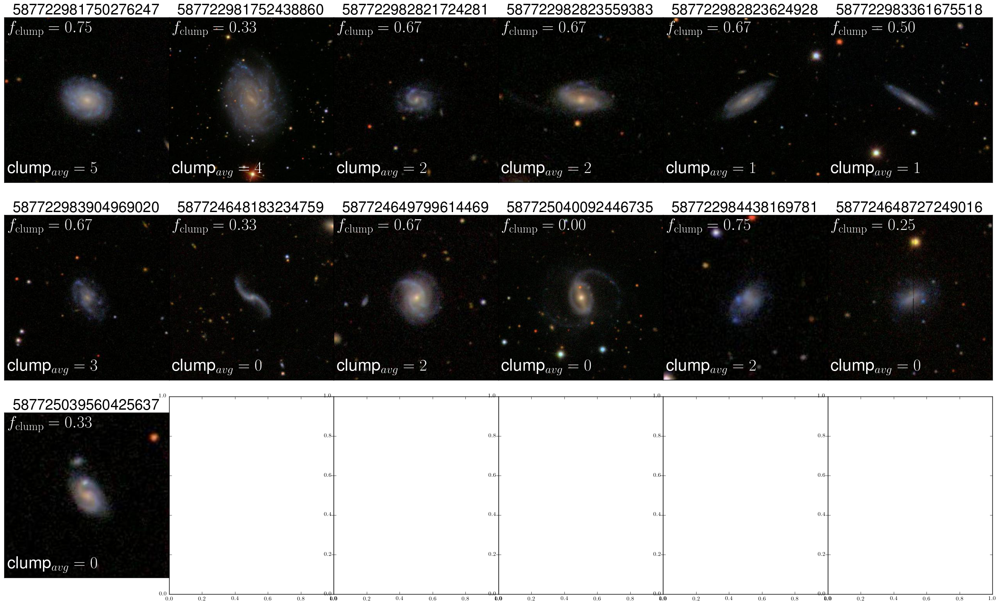

In [27]:
show_jpegs(clumpdump[reg_of_zoom], img_type='regular', print_fraction=True)

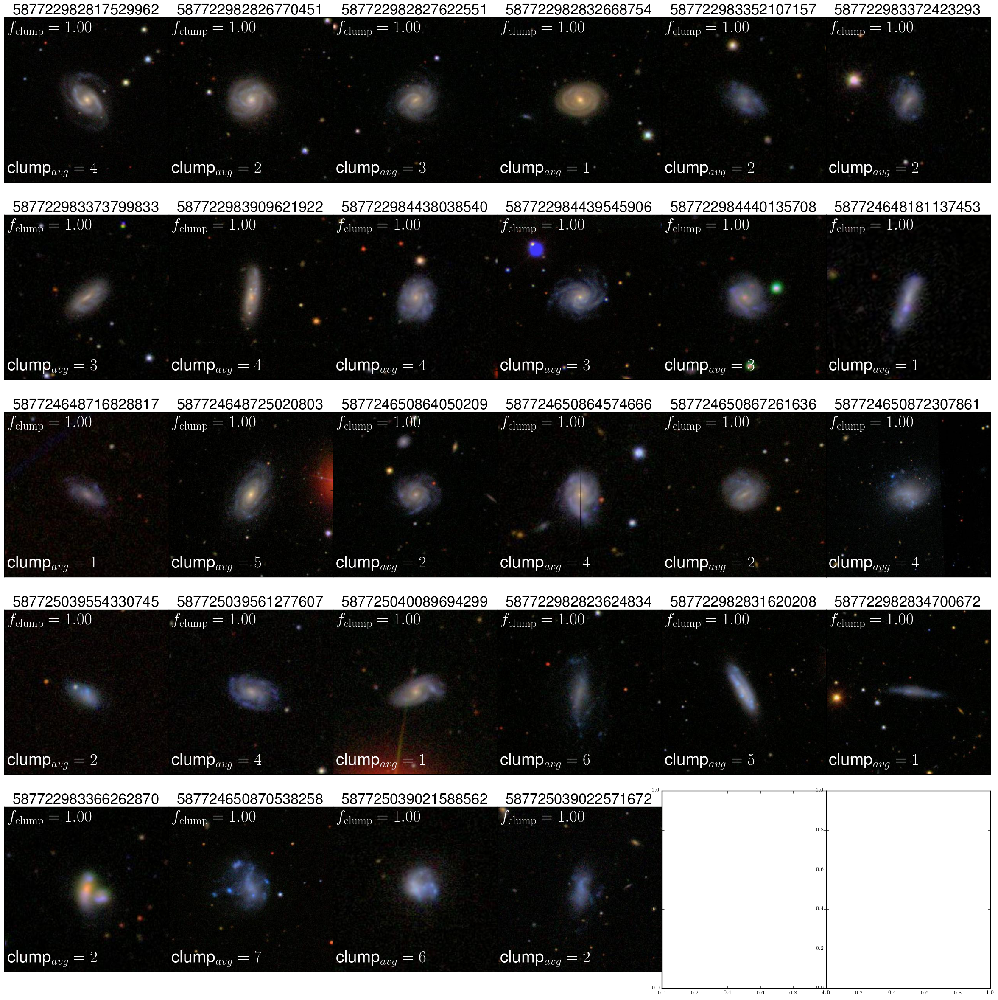

In [25]:
show_jpegs(clumpy[reg_only], img_type='regular', print_fraction=True)

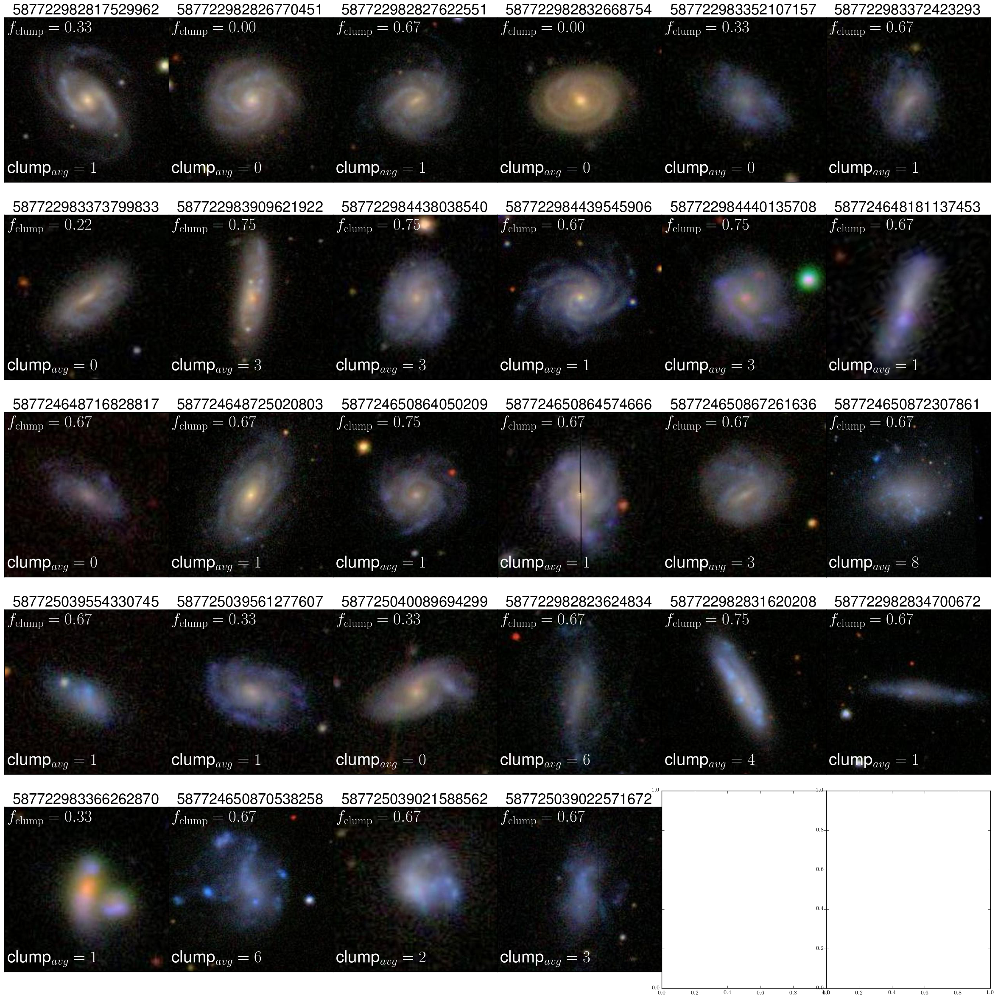

In [30]:
show_jpegs(clumpdump[zoom_of_reg], img_type='zoomed', print_fraction=True)